In [1]:
# Import matplotlib.pyplot
import matplotlib.pyplot as plt
%matplotlib inline
import pandas as pd
import numpy as np

## Building 2-layer maps : combining polygons and scatterplots

### Styling a scatterplot

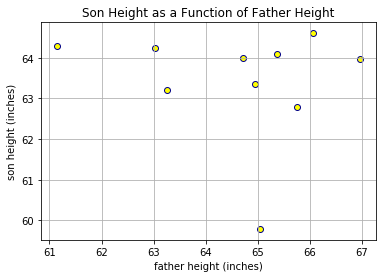

In [2]:
fheight = [65.04851, 63.25094, 64.95532, 65.7525, 61.13723, 63.02254, 65.37053, 64.72398000000001, 66.06509, 66.96738]
sheight = [59.77826999999999, 63.214040000000004, 63.34242, 62.79238, 64.28113, 64.24221, 64.08230999999999, 63.995740000000005, 64.61338, 63.979440000000004]
# Scatterplot 3
plt.scatter(fheight, sheight,  c = 'yellow', edgecolor = 'darkblue')
plt.grid()
plt.xlabel('father height (inches)')
plt.ylabel('son height (inches)')
plt.title('Son Height as a Function of Father Height')

# Show your plot
plt.show()

### Extracting longitude and latitude

In [3]:
l = [[4431, 'MUSIC CITY CENTRAL 5TH - BAY 11', (36.16659, -86.781996), 36.16659, -86.781996], [588, 'CHARLOTTE AVE & 7TH AVE N WB', (36.165, -86.78406), 36.165, -86.78406], [590, 'CHARLOTTE AVE & 8TH AVE N WB', (36.164393, -86.785451), 36.164393, -86.785451], [541, '11TH AVE / N GULCH STATION OUTBOUND', (36.162249, -86.790464), 36.162249, -86.790464]]
df = pd.DataFrame(l, columns = ['StopID', 'StopName', 'Location', 'lat', 'lng'])

In [4]:
# print the first few rows of df 
print(df.head())

# extract latitude to a new column: lat
df['lat'] = [loc[0] for loc in df.Location]

# extract longitude to a new column: lng
df['lng'] = [loc[1] for loc in df.Location]

# print the first few rows of df again
print(df.head())

   StopID                             StopName                 Location  \
0    4431      MUSIC CITY CENTRAL 5TH - BAY 11   (36.16659, -86.781996)   
1     588         CHARLOTTE AVE & 7TH AVE N WB      (36.165, -86.78406)   
2     590         CHARLOTTE AVE & 8TH AVE N WB  (36.164393, -86.785451)   
3     541  11TH AVE / N GULCH STATION OUTBOUND  (36.162249, -86.790464)   

         lat        lng  
0  36.166590 -86.781996  
1  36.165000 -86.784060  
2  36.164393 -86.785451  
3  36.162249 -86.790464  
   StopID                             StopName                 Location  \
0    4431      MUSIC CITY CENTRAL 5TH - BAY 11   (36.16659, -86.781996)   
1     588         CHARLOTTE AVE & 7TH AVE N WB      (36.165, -86.78406)   
2     590         CHARLOTTE AVE & 8TH AVE N WB  (36.164393, -86.785451)   
3     541  11TH AVE / N GULCH STATION OUTBOUND  (36.162249, -86.790464)   

         lat        lng  
0  36.166590 -86.781996  
1  36.165000 -86.784060  
2  36.164393 -86.785451  
3  36.162249 -

### Plotting chicken locations

   Unnamed: 0  permit       city state    zip  district date_issued  \
0           0   288.0  Nashville    TN  37211      30.0  11/26/2014   
1           1   435.0  Nashville    TN  37211      19.0  05/18/2015   
2           2   270.0  Nashville    TN  37216       7.0  11/20/2014   
3           3   249.0  Nashville    TN  37216      25.0  12/29/2014   
4           4   200.0  Nashville    TN  37221      22.0  12/10/2014   

         lat        lng  
0  36.029132 -86.724578  
1  36.069132 -86.754578  
2  36.236134 -86.711204  
3  36.246134 -86.751204  
4  36.029367 -86.935290  


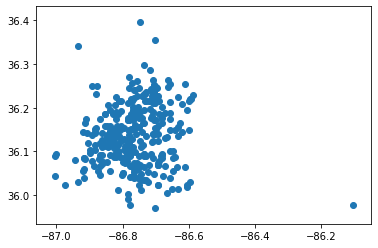

In [5]:
chickens_path = 'https://assets.datacamp.com/production/repositories/2409/datasets/fa767727ef9a7b39fb9f34bee3b1bc2f02682c81/Domesticated_Hen_Permits_clean_adjusted_lat_lng.csv'

# Load the dataset
chickens = pd.read_csv(chickens_path)

# Look at the first few rows of the chickens DataFrame
print(chickens.head())

# Plot the locations of all Nashville chicken permits
plt.scatter(x = chickens.lng, y = chickens.lat)

# Show the plot
plt.show()

### Creating a GeoDataFrame & examining the geometry

In [6]:
l = [[198.0, 0.0, 'Urban Services District'], [327.0, 4.0, 'General Services District']]
df = pd.DataFrame(l, columns = ['area_sq_mi', 'objectid', 'name'])
df.head()

,area_sq_mi,objectid,name
0,198.0,0.0,Urban Services District
1,327.0,4.0,General Services District


In [7]:
# # Read in the services district shapefile and look at the first few rows.
# service_district = gpd.read_file(shapefile_path)
# print(service_district.head())

# # Print the contents of the service districts geometry in the first row
# print(service_district.loc[0, 'geometry'])

### Plotting points over polygons 

In [8]:
# # Plot the service district shapefile
# service_district.plot(column='name', legend=True)

# # Add the chicken locations
# plt.scatter(x=chickens.lng, y=chickens.lat, c='black', edgecolor = 'white')


# # Add labels and title
# plt.title('Nashville Chicken Permits')
# plt.xlabel('longitude' )
# plt.ylabel('latitude')

# # Add grid lines and show the plot
# plt.grid()
# plt.show()

## Creating and joining GeoDataFrames

### Colormaps

In [9]:
import geopandas as gpd
school_districts = gpd.read_file('school_districts.geojson')

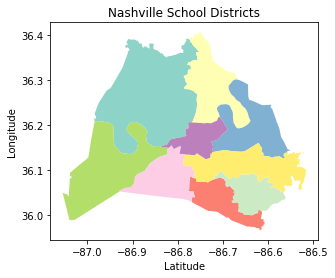

In [10]:
# Set legend style
lgnd_kwds = {'title': 'School Districts',
               'loc': 'upper left', 'bbox_to_anchor': (1, 1.03), 'ncol': 1}

# Plot the school districts using Set3 colormap without the column argument
school_districts.plot(cmap = 'Set3', legend = True, legend_kwds = lgnd_kwds)
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Nashville School Districts')
plt.show();

### Map Nashville neighborhoods

                   name                                           geometry
0  Historic Buena Vista  (POLYGON ((-86.79511056795417 36.1757596496334...
1        Charlotte Park  (POLYGON ((-86.87459668651866 36.1575770268129...
2              Hillwood  (POLYGON ((-86.87613708067906 36.1355409894979...
3            West Meade  (POLYGON ((-86.9038380396094 36.1255414807897,...
4          White Bridge  (POLYGON ((-86.86321427797685 36.1288622289404...


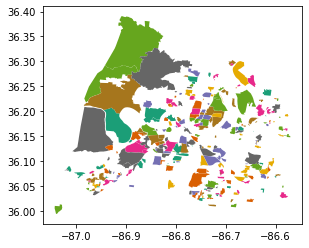

In [11]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Read in the neighborhoods geojson file
neighborhoods = gpd.read_file('neighborhoods.geojson')

# Print the first few rows of neighborhoods
print(neighborhoods.head())

# Plot the neighborhoods, color according to name and use the Dark2 colormap
neighborhoods.plot(column = 'name', cmap = 'Dark2')

# Show the plot.
plt.show()

### Changing coordinate reference systems

In [12]:
# Print the first row of school districts GeoDataFrame and the crs
print(school_districts.head(1))
print(school_districts.crs)

# Convert the crs to epsg:3857
school_districts.geometry = school_districts.geometry.to_crs(epsg = 3857)
                        
# Print the first row of school districts GeoDataFrame and the crs again
print(school_districts.head(1))
print(school_districts.crs)

   first_name       city    zip                           email state  \
0  Dr. Sharon  Nashville  37218  gentryfordistrict1@comcast.net    TN   

  last_name          address position term_expir district         phone  \
0    Gentry  6108 Beals Lane   Member       2016        1  615-268-5269   

                                            geometry  
0  (POLYGON ((-86.77136400034288 36.3835669997190...  
{'init': 'epsg:4326'}
   first_name       city    zip                           email state  \
0  Dr. Sharon  Nashville  37218  gentryfordistrict1@comcast.net    TN   

  last_name          address position term_expir district         phone  \
0    Gentry  6108 Beals Lane   Member       2016        1  615-268-5269   

                                            geometry  
0  (POLYGON ((-9659344.055955959 4353528.76657080...  
{'init': 'epsg:3857', 'no_defs': True}


### Construct a GeoDataFrame from a DataFrame

In [13]:
art = pd.read_csv('public_art.csv')
art.columns = ['title', 'last_name', 'first_name', 'address', 'medium', 'type', 'desc', 'lat', 'lng', 'loc']
art.head()

,title,last_name,first_name,address,medium,type,desc,lat,lng,loc
0,[Cross Country Runners],Frost,Miley,"4001 Harding Rd., Nashville TN",Bronze,Sculpture,NaN,36.12856,-86.83660,"(36.12856, -86.8366)"
1,[Fourth and Commerce Sculpture],Walker,Lin,"333 Commerce Street, Nashville TN",NaN,Sculpture,NaN,36.16234,-86.77774,"(36.16234, -86.77774)"
2,12th & Porter Mural,Kennedy,Kim,114 12th Avenue N,Porter all-weather outdoor paint,Mural,Kim Kennedy is a musician and visual artist wh...,36.15790,-86.78817,"(36.1579, -86.78817)"
3,A Splash of Color,Stevenson and Stanley and ROFF (Harroff),Doug and Ronnica and Lynn,616 17th Ave. N.,"Steel, brick, wood, and fabric on frostproof c...",Mural,Painted wooden hoop dancer on a twenty foot po...,36.16202,-86.79975,"(36.16202, -86.79975)"
4,A Story of Nashville,Ridley,Greg,"615 Church Street, Nashville TN",Hammered copper repousse,Frieze,"Inside the Grand Reading Room, this is a serie...",36.16215,-86.78205,"(36.16215, -86.78205)"


In [14]:
from shapely.geometry import Point

# Print the first few rows of the art DataFrame
print(art.head())

# Create a geometry column from lng & lat
art['geometry'] = art.apply(lambda x: Point(float(x.lng), float(x.lat)), axis=1)

# Create a GeoDataFrame from art and verify the type
art_geo = gpd.GeoDataFrame(art, crs = neighborhoods.crs, geometry = art.geometry)
print(type(art_geo))


                             title                                 last_name  \
0          [Cross Country Runners]                                     Frost   
1  [Fourth and Commerce Sculpture]                                    Walker   
2              12th & Porter Mural                                   Kennedy   
3                A Splash of Color  Stevenson and Stanley and ROFF (Harroff)   
4             A Story of Nashville                                    Ridley   

                  first_name                            address  \
0                      Miley     4001 Harding Rd., Nashville TN   
1                        Lin  333 Commerce Street, Nashville TN   
2                        Kim                  114 12th Avenue N   
3  Doug and Ronnica and Lynn                   616 17th Ave. N.   
4                       Greg    615 Church Street, Nashville TN   

                                              medium       type  \
0                                             Bro

### Spatial join practice

Write a spatial join to find the art in art_geo that intersects with neighborhoods. Call this art_intersect_neighborhoods and print the .shape property to see how many rows and columns resulted.

In [15]:
# Spatially join art_geo and neighborhoods
art_intersect_neighborhoods = gpd.sjoin(art_geo, neighborhoods, op = 'intersects')

# Print the shape property of art_intersect_neighborhoods
print(art_intersect_neighborhoods.shape)

(40, 13)


Now write a spatial join to find the art in art_geo that is within neighborhoods. Call this art_within_neighborhoods and take a look at the .shape property to see how many rows and columns resulted.

In [16]:
# Create art_within_neighborhoods by spatially joining art_geo and neighborhoods
art_within_neighborhoods = gpd.sjoin(art_geo, neighborhoods, op = 'within')

# Print the shape property of art_within_neighborhoods
print(art_within_neighborhoods.shape)

(40, 13)


Finally, write a spatial join to find the art locations in art_geo that contain neighborhoods. Call this GeoDataFrame art_containing_neighborhoods and take a look at the .shape property to see how many rows and columns resulted.

In [17]:
# Spatially join art_geo and neighborhoods and using the contains op

art_containing_neighborhoods = gpd.sjoin(art_geo, neighborhoods, op = 'contains')

# Print the shape property of art_containing_neighborhoods
print(art_containing_neighborhoods.shape)

(0, 13)


### Finding the neighborhood with the most public art

In [18]:
# Spatially join neighborhoods with art_geo
neighborhood_art = gpd.sjoin(art_geo, neighborhoods, op = "within")

# Print the first few rows
print(neighborhood_art.head())

                                title last_name first_name  \
1     [Fourth and Commerce Sculpture]    Walker        Lin   
4                A Story of Nashville    Ridley       Greg   
21                        Chet Atkins     Faxon    Russell   
22  Children's Chairs For The Seasons    McGraw     Deloss   
34                    Foliated Scroll   Bloomer       Kent   

                                              address  \
1                   333 Commerce Street, Nashville TN   
4                     615 Church Street, Nashville TN   
21  Corner of Fifth Avenue North and Union Street,...   
22                    615 Church Street, Nashville TN   
34                    615 Church Street, Nashville TN   

                                         medium       type  \
1                                           NaN  Sculpture   
4                      Hammered copper repousse     Frieze   
21  Bronze stool and guitar on a granite plynth  Sculpture   
22                 Mixed Media - woo

### Aggregating points within polygons

In [19]:
# Get name and title from neighborhood_art and group by name
neighborhood_art_grouped = neighborhood_art[['name', 'title']].groupby('name')

# Aggregate the grouped data and count the artworks within each polygon
print(neighborhood_art_grouped.agg('count').sort_values(by = 'title', ascending = False))

                          title
name                           
Urban Residents              22
Lockeland Springs             3
Edgehill (ONE)                2
Germantown                    2
Hillsboro-West End            2
Inglewood                     2
Sunnyside                     2
Chestnut Hill (TAG)           1
Historic Edgefield            1
McFerrin Park                 1
Renraw                        1
Wedgewood Houston (SNAP)      1


### Plotting the Urban Residents neighborhood and art

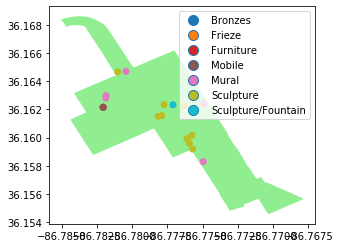

In [20]:
# Create urban_art from neighborhood_art where the neighborhood name is Urban Residents
urban_art = neighborhood_art.loc[neighborhood_art.name == "Urban Residents"]

# Get just the Urban Residents neighborhood polygon and save it as urban_polygon
urban_polygon = neighborhoods.loc[neighborhoods.name == "Urban Residents"]

# Plot the urban_polygon as ax 
ax = urban_polygon.plot(color = 'lightgreen')

# Add a plot of the urban_art and show it
urban_art.plot( ax = ax, column = 'type', legend = True);
plt.show()

## GeoSeries and folium

### Find the area of the Urban Residents neighborhood

In [21]:
# Print the head of the urban polygon 
print(urban_polygon.head())

# Create a copy of the urban_polygon using EPSG:3857 and print the head
urban_poly_3857 = urban_polygon.to_crs(epsg = 3857)
print(urban_poly_3857.head())

# Print the area of urban_poly_3857 in kilometers squared
area = urban_poly_3857.geometry.area / 10**6
print('The area of the Urban Residents neighborhood is ', area.values[0], ' km squared')


               name                                           geometry
41  Urban Residents  (POLYGON ((-86.78122053774267 36.1645653773768...
               name                                           geometry
41  Urban Residents  (POLYGON ((-9660441.280680289 4323289.00479539...
The area of the Urban Residents neighborhood is  1.1289896057982676  km squared


### The center of the Urban Residents neighborhood

<class 'geopandas.geoseries.GeoSeries'>


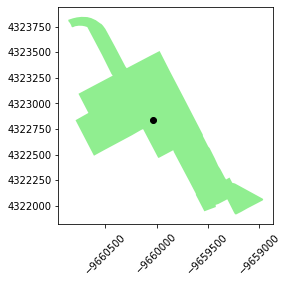

In [22]:
# Create downtown_center from urban_poly_3857
downtown_center = urban_poly_3857.geometry.centroid

# Print the type of downtown_center 
print(type(downtown_center))

# Plot the urban_poly_3857 as ax and add the center point
ax = urban_poly_3857.plot(color = 'lightgreen')
downtown_center.plot(ax = ax, color = 'black')
plt.xticks(rotation = 45)

# Show the plot
plt.show()

### Prepare to calculate distances

In [23]:
# Import packages
from shapely.geometry import Point
import geopandas as gpd
import pandas as pd

# Create art_dist_meters using art and the geometry from art
art_dist_meters = gpd.GeoDataFrame(art, geometry = art.geometry, crs = {'init': 'epsg:4326'})
print(art_dist_meters.head(2))

# Set the crs of art_dist_meters to use EPSG:3857
art_dist_meters.geometry = art_dist_meters.geometry.to_crs(epsg = 3857)
print(art_dist_meters.head(2))
art_dist_meters.values.tolist()[0]
# Add a column to art_meters, center
art_dist_meters['center'] = Point(-9660034.312198792, 4322835.782813124)

                             title last_name first_name  \
0          [Cross Country Runners]     Frost      Miley   
1  [Fourth and Commerce Sculpture]    Walker        Lin   

                             address  medium       type desc       lat  \
0     4001 Harding Rd., Nashville TN  Bronze  Sculpture  NaN  36.12856   
1  333 Commerce Street, Nashville TN     NaN  Sculpture  NaN  36.16234   

        lng                    loc                             geometry  
0 -86.83660   (36.12856, -86.8366)            POINT (-86.8366 36.12856)  
1 -86.77774  (36.16234, -86.77774)  POINT (-86.77774000000001 36.16234)  
                             title last_name first_name  \
0          [Cross Country Runners]     Frost      Miley   
1  [Fourth and Commerce Sculpture]    Walker        Lin   

                             address  medium       type desc       lat  \
0     4001 Harding Rd., Nashville TN  Bronze  Sculpture  NaN  36.12856   
1  333 Commerce Street, Nashville TN     NaN  Sculp

### Art distances from neighborhood center

In [24]:
# Import package for pretty printing
import pprint

# Build a dictionary of titles and distances for Urban Residents art
art_distances = {}
for row in art_dist_meters.iterrows():
    vals = row[1]
    key = vals['title']
    ctr = vals['center']
    art_distances[key] = vals['geometry'].distance(ctr)

# Print the art_distances
pprint.pprint(art_distances)

{'12th & Porter Mural': 1269.1502879123295,
 'A Splash of Color': 2471.7747384559425,
 'A Story of Nashville': 513.5632030470281,
 'Aerial Innovations Mural': 4516.755210408422,
 'Airport Sun Project': 12797.594229783645,
 'Andrew Jackson': 948.9812821647014,
 'Angel': 10202.565989739454,
 'Anticipation': 688.834910528029,
 'April Baby': 4779.394424949201,
 'Arial Triangle [from the Gravity Series]': 4315.322141146862,
 'Ariel': 4380.927773956353,
 'Athena Parthenos': 4294.778095689676,
 'Benedictio': 5313.624214291833,
 'Bicycle Bus-Green Fleet': 468.08286355623386,
 'Blowing Bubbles': 10202.565989739454,
 'Breaking Bread': 1279.2562933101267,
 'Building a Positive Community': 2253.417997416559,
 'Can-Do': 5648.0863220822475,
 'Chet Atkins': 604.4489448101176,
 "Children's Chairs For The Seasons": 513.5632030470281,
 'Confederate Memorial': 5313.624214291833,
 'Confederate Private Monument': 4316.459103419423,
 'Confluence': 2918.52441210167,
 'Cool Fences': 6491.846030117232,
 'Danci

### Create a folium location from the urban centroid

In [25]:
# Print the head of the urban_polygon
print(urban_polygon.head())

# Create urban_center from the urban_polygon center
# urban_center = urban_polygon.center[0]
urban_center = Point(-86.77756457127047, 36.16127820928791)

# Print urban_center
print(urban_center)

# Create array for folium called urban_location
urban_location = [urban_center.y, urban_center.x]

# Print urban_location
print(urban_location)

               name                                           geometry
41  Urban Residents  (POLYGON ((-86.78122053774267 36.1645653773768...
POINT (-86.77756457127047 36.16127820928791)
[36.16127820928791, -86.77756457127047]


### Create a folium map of downtown Nashville

In [26]:
import folium
# Construct a folium map with urban_location
downtown_map = folium.Map(location = urban_location, zoom_start = 15)

# Display the map
display(downtown_map)

### Folium street map of the downtown neighborhood

In [27]:
# Create array for called folium_loc from the urban_polygon center point
# point = urban_polygon.center[0]
point = Point(-86.77756457127047, 36.16127820928791)
folium_loc = [point.y, point.x]

# Construct a map from folium_loc: downtown_map
downtown_map = folium.Map(location = folium_loc, zoom_start = 15)

# Draw our neighborhood: Urban Residents
folium.GeoJson(urban_polygon.geometry).add_to(downtown_map)

# Display the map
display(downtown_map)

### Adding markers for the public art

In [28]:
# Iterate through the urban_art and print each part of tuple returned
for row in urban_art.iterrows():
    print('first part: ', row[0])
    print('second part: ', row[1])

# Create a location and marker with each iteration for the downtown_map
for row in urban_art.iterrows():
    row_values = row[1] 
    location = [row_values['lng'], row_values['lat']]
    marker = folium.Marker(location = location)
    marker.add_to(downtown_map)

# Display the map
display(downtown_map)

first part:  1
second part:  title              [Fourth and Commerce Sculpture]
last_name                                   Walker
first_name                                     Lin
address          333 Commerce Street, Nashville TN
medium                                         NaN
type                                     Sculpture
desc                                           NaN
lat                                        36.1623
lng                                       -86.7777
loc                          (36.16234, -86.77774)
geometry       POINT (-86.77774000000001 36.16234)
index_right                                     41
name                               Urban Residents
Name: 1, dtype: object
first part:  4
second part:  title                                       A Story of Nashville
last_name                                                 Ridley
first_name                                                  Greg
address                          615 Church Street, Nashville

### Troubleshooting data issues

In [29]:
# Print the urban_art titles
print(urban_art.title)

#Print the urban_art descriptions
print(urban_art.desc)

# Replace Nan and ' values in description
urban_art.desc.fillna('', inplace = True)
urban_art.desc = urban_art.desc.str.replace("'", "`")

#Print the urban_art descriptions again
print(urban_art.desc)

1                        [Fourth and Commerce Sculpture]
4                                   A Story of Nashville
21                                           Chet Atkins
22                     Children's Chairs For The Seasons
34                                       Foliated Scroll
39                                          Gone Fishing
40                             Happy Times at The Arcade
54                                     Johnny Cash Mural
55                                 La Storia della Terra
57                                 Les Paul Guitar Mural
59                                         Library Doors
60                               Lightning Wire Fountain
66     Nashville, A History through Maps and Aerial V...
67                                               Oh, Roy
68                                  Orpheus and Eurydice
75                               Piecing It All Together
104                                  The Birth of Apollo
105                            

/Users/huiren/anaconda3/envs/geo/lib/python3.6/site-packages/pandas/core/generic.py:6130: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._update_inplace(new_data)
/Users/huiren/anaconda3/envs/geo/lib/python3.6/site-packages/pandas/core/generic.py:5096: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[name] = value


### A map of downtown art

In [30]:
nashville = [36.16127820928791, -86.77756457127047]
# Construct downtown map
downtown_map = folium.Map(location = nashville, zoom_start = 15)
folium.GeoJson(urban_polygon).add_to(downtown_map)

# Create popups inside the loop you built to create the markers
for row in urban_art.iterrows():
    row_values = row[1] 
    location = [row_values['lat'], row_values['lng']]
    popup = (str(row_values['title']) + ': ' + 
             str(row_values['desc'])).replace("'", "`")
    marker = folium.Marker(location = location, popup = popup)
    marker.add_to(downtown_map)

# Display the map.
display(downtown_map)

## Creating a choropleth building permit density in Nashville

### Finding counts from a spatial join

In [31]:
permits = pd.read_csv('building_permits_2017.csv')
permits.head()

,permit_id,issued,cost,lat,lng
0,2017032777,2017-05-24,226201.0,36.198241,-86.742235
1,2017061156,2017-10-23,15000.0,36.151554,-86.830222
2,2017074521,2017-11-20,13389.0,36.034239,-86.708892
3,2017035041,2017-05-30,40000.0,36.128659,-86.841815
4,2017000049,2017-01-09,268107.0,36.045042,-86.616211


In [32]:
council_districts = gpd.read_file('council_districts.geojson')

In [33]:
# Create a shapely Point from lat and lng
permits['geometry'] = permits.apply(lambda x: Point((x.lng , x.lat)), axis = 1)

# Build a GeoDataFrame: permits_geo
permits_geo = gpd.GeoDataFrame(permits, crs = council_districts.crs, geometry = permits.geometry)

# Spatial join of permits_geo and council_districts
permits_by_district = gpd.sjoin(permits_geo, council_districts, op = 'within')
print(permits_by_district.head(2))

# Create permit_counts
permit_counts = permits_by_district.groupby(['district']).size()
print(permit_counts)

     permit_id      issued      cost        lat        lng  \
0   2017032777  2017-05-24  226201.0  36.198241 -86.742235   
68  2017053890  2017-09-05       0.0  36.185442 -86.768239   

                                geometry  index_right first_name  \
0   POINT (-86.74223499999999 36.198241)            5      Scott   
68  POINT (-86.76823900000001 36.185442)            5      Scott   

                        email     res_phone     bus_phone last_name  \
0   scott.davis@nashville.gov  615-554-9730  615-862-6780     Davis   
68  scott.davis@nashville.gov  615-554-9730  615-862-6780     Davis   

          position district  
0   Council Member        5  
68  Council Member        5  
district
1     146
10    119
11    239
12    163
13    139
14    261
15    322
16    303
17    786
18    287
19    969
2     399
20    799
21    569
22    291
23    206
24    458
25    435
26    179
27    105
28    119
29    154
3     215
30     79
31    134
32    225
33    355
34    218
35    192
4    

### Council district areas and permit counts

In [34]:
# Create an area column in council_districts
council_districts['area'] = council_districts.geometry.area
print(council_districts.head(2))

  first_name                           email     res_phone     bus_phone  \
0       Nick     nick.leonardo@nashville.gov  615-509-6334  615-862-6780   
1    DeCosta  decosta.hastings@nashville.gov  615-779-1565  615-862-6780   

  last_name        position district  \
0  Leonardo  Council Member        1   
1  Hastings  Council Member        2   

                                            geometry      area  
0  (POLYGON ((-86.90738248774342 36.3905151283193...  0.022786  
1  (POLYGON ((-86.75902399986667 36.2309080000732...  0.002927  


In [35]:
# Convert permit_counts to a DataFrame
permits_df = permit_counts.to_frame()
print(permits_df.head(2))

            0
district     
1         146
10        119


In [36]:
# Reset index and column names
permits_df.reset_index(inplace=True)
permits_df.columns = ['district', 'bldg_permits']
print(permits_df.head(2))

  district  bldg_permits
0        1           146
1       10           119


In [37]:
# Merge council_districts and permits_df: 
districts_and_permits = pd.merge(council_districts, permits_df, on = 'district')
print(districts_and_permits.head(2))

  first_name                           email     res_phone     bus_phone  \
0       Nick     nick.leonardo@nashville.gov  615-509-6334  615-862-6780   
1    DeCosta  decosta.hastings@nashville.gov  615-779-1565  615-862-6780   

  last_name        position district  \
0  Leonardo  Council Member        1   
1  Hastings  Council Member        2   

                                            geometry      area  bldg_permits  
0  (POLYGON ((-86.90738248774342 36.3905151283193...  0.022786           146  
1  (POLYGON ((-86.75902399986667 36.2309080000732...  0.002927           399  


### Calculating a normalized metric

In [38]:
# Print the type of districts_and_permits
print(type(districts_and_permits))

# Create permit_density column in districts_and_permits
districts_and_permits['permit_density'] = districts_and_permits.apply(lambda row: row.bldg_permits / row.area, axis = 1)

# Print the head of districts_and_permits
print(districts_and_permits.head())

<class 'geopandas.geodataframe.GeoDataFrame'>
  first_name                           email     res_phone     bus_phone  \
0       Nick     nick.leonardo@nashville.gov  615-509-6334  615-862-6780   
1    DeCosta  decosta.hastings@nashville.gov  615-779-1565  615-862-6780   
2      Nancy    nancy.vanreece@nashville.gov  615-576-0488  615-862-6780   
3       Bill    bill.pridemore@nashville.gov  615-915-1419  615-862-6780   
4     Robert      robert.swope@nashville.gov  615-308-0577  615-862-6780   

   last_name        position district  \
0   Leonardo  Council Member        1   
1   Hastings  Council Member        2   
2   VanReece  Council Member        8   
3  Pridemore  Council Member        9   
4      Swope  Council Member        4   

                                            geometry      area  bldg_permits  \
0  (POLYGON ((-86.90738248774342 36.3905151283193...  0.022786           146   
1  (POLYGON ((-86.75902399986667 36.2309080000732...  0.002927           399   
2  (POLYGO

### Geopandas choropleths

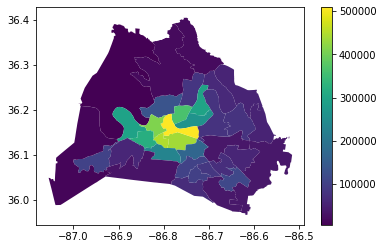

In [39]:
# Import packages
import matplotlib.pyplot as plt
import pandas as pd
import geopandas as gpd

# Simple plot of building permit_density
districts_and_permits.plot(column = 'permit_density', legend = True);
plt.show();

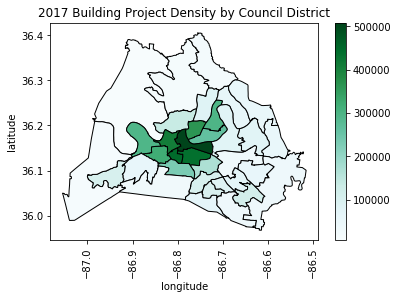

In [40]:
# Polished choropleth of building permit_density
districts_and_permits.plot(column = 'permit_density', cmap = 'BuGn', edgecolor = 'black', legend = True)
plt.xlabel('longitude')
plt.ylabel('latitude')
plt.xticks(rotation = 'vertical')
plt.title('2017 Building Project Density by Council District')
plt.show();

### Area in km squared, geometry in decimal degrees

In [41]:
# Change council_districts crs to epsg 3857
council_districts = council_districts.to_crs(epsg = 3857)
print(council_districts.crs)
print(council_districts.head())

# Create area in square km
sqm_to_sqkm = 10**6
council_districts['area'] = council_districts.geometry.area / sqm_to_sqkm

# Change council_districts crs back to epsg 4326
council_districts = council_districts.to_crs(epsg = 4326)
print(council_districts.crs)
print(council_districts.head())

{'init': 'epsg:3857', 'no_defs': True}
  first_name                           email     res_phone     bus_phone  \
0       Nick     nick.leonardo@nashville.gov  615-509-6334  615-862-6780   
1    DeCosta  decosta.hastings@nashville.gov  615-779-1565  615-862-6780   
2      Nancy    nancy.vanreece@nashville.gov  615-576-0488  615-862-6780   
3       Bill    bill.pridemore@nashville.gov  615-915-1419  615-862-6780   
4     Robert      robert.swope@nashville.gov  615-308-0577  615-862-6780   

   last_name        position district  \
0   Leonardo  Council Member        1   
1   Hastings  Council Member        2   
2   VanReece  Council Member        8   
3  Pridemore  Council Member        9   
4      Swope  Council Member        4   

                                            geometry      area  
0  (POLYGON ((-9674485.564711858 4354489.55569189...  0.022786  
1  (POLYGON ((-9657970.37338656 4332440.649821124...  0.002927  
2  (POLYGON ((-9654572.679891953 4339671.15221535...  0.002517

### Spatially joining and getting counts

In [42]:
# Create permits_geo
permits_geo = gpd.GeoDataFrame(permits, crs = council_districts.crs, geometry = permits.geometry)

# Spatially join permits_geo and council_districts
permits_by_district = gpd.sjoin(permits_geo, council_districts, op = 'within')
print(permits_by_district.head(2))

# Count permits in each district
permit_counts = permits_by_district.groupby('district').size()

# Convert permit_counts to a df with 2 columns: district and bldg_permits
counts_df = permit_counts.to_frame()
counts_df.reset_index(inplace=True)
counts_df.columns = ['district', 'bldg_permits']
print(counts_df.head(2))

     permit_id      issued      cost        lat        lng  \
0   2017032777  2017-05-24  226201.0  36.198241 -86.742235   
68  2017053890  2017-09-05       0.0  36.185442 -86.768239   

                                geometry  index_right first_name  \
0   POINT (-86.74223499999999 36.198241)            5      Scott   
68  POINT (-86.76823900000001 36.185442)            5      Scott   

                        email     res_phone     bus_phone last_name  \
0   scott.davis@nashville.gov  615-554-9730  615-862-6780     Davis   
68  scott.davis@nashville.gov  615-554-9730  615-862-6780     Davis   

          position district       area  
0   Council Member        5  19.030612  
68  Council Member        5  19.030612  
  district  bldg_permits
0        1           146
1       10           119


### Building a polished Geopandas choropleth

    permit_id      issued      cost        lat        lng  \
0  2017032777  2017-05-24  226201.0  36.198241 -86.742235   
1  2017053890  2017-09-05       0.0  36.185442 -86.768239   

                               geometry  index_right first_name  \
0  POINT (-86.74223499999999 36.198241)            5      Scott   
1  POINT (-86.76823900000001 36.185442)            5      Scott   

                       email     res_phone     bus_phone last_name  \
0  scott.davis@nashville.gov  615-554-9730  615-862-6780     Davis   
1  scott.davis@nashville.gov  615-554-9730  615-862-6780     Davis   

         position district       area  bldg_permits  permit_density  
0  Council Member        5  19.030612           452       23.751207  
1  Council Member        5  19.030612           452       23.751207  


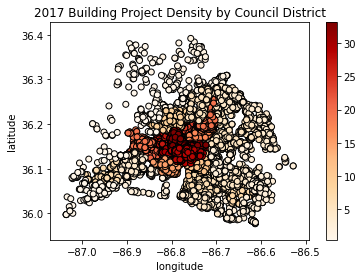

In [43]:
# Merge permits_by_district and counts_df
districts_and_permits = pd.merge(permits_by_district, counts_df, on = 'district')

# Create permit_density column
districts_and_permits['permit_density'] = districts_and_permits.apply(lambda row: row.bldg_permits / row.area, axis = 1)
print(districts_and_permits.head(2))

# Create choropleth plot
districts_and_permits.plot(column = 'permit_density', cmap = 'OrRd', edgecolor = 'black', legend = True)

# Add axis labels and title
plt.xlabel('longitude')
plt.ylabel('latitude')
plt.title('2017 Building Project Density by Council District')
plt.show()

### Folium choropleth

In [44]:
# Center point for Nashville
nashville = [36.1636,-86.7823]

# Create map
m = folium.Map(location=nashville, zoom_start=10)

In [45]:
# Build choropleth
m.choropleth(
    geo_data=districts_and_permits,
    name='geometry',
    data=districts_and_permits,
    columns=['district', 'permit_density'],
    key_on='feature.properties.district',
    fill_color='Reds',
    fill_opacity=0.5,
    line_opacity=1.0,
    legend_name='2017 Permitted Building Projects per km squared'
)

/Users/huiren/anaconda3/envs/geo/lib/python3.6/site-packages/folium/folium.py:415: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


In [46]:
# Create LayerControl and add it to the map            
folium.LayerControl().add_to(m)

# Display the map
display(m)  

### Folium choropleth with markers and popups

In [47]:
# Create center column for the centroid of each district
districts_and_permits['center'] = districts_and_permits.geometry.centroid

# Build markers and popups
for row in districts_and_permits.iterrows():
    row_values = row[1]
    center_point = row_values['center']
    location = [center_point.y, center_point.x]
    popup = ('Council District: ' + str(row_values['district']) + 
             ';  ' + 'permits issued: ' + str(row_values['bldg_permits']))
    marker = folium.Marker(location = location, popup = popup)
    marker.add_to(m)
    
# Display the map
display(m)